# Trajectory analysis for the mTECII -> mTECIII lineage for discovery of terminally differentiated mTECIII sublineages
Author - Veronika Kedlian

steps: 
-  Subset mTECII and mTECIII cells 
-  Batch correct this sub lineage 
-  Annotate new subtypes based on genes that are spatially associated to HC (done in a different notebook) 
-  Perform trajectory analysis 

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import warnings 
import scipy.stats
from collections import Counter
import os

warnings.filterwarnings('ignore')
#os.chdir('/nfs/team205/ny1/ThymusSpatialAtlas/ImageSpot/')
#import scvi_wrapper as s_w
import statsmodels.api as sm
import scvi

In [ ]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

sc.logging.print_header()
import matplotlib
import matplotlib.pyplot as plt 
from matplotlib import font_manager 
font_manager.fontManager.addfont(".../Arial.ttf") 
print(font_manager.findfont("Arial")) 
plt.rcParams["font.sans-serif"] = ["Arial"] 
plt.rcParams["pdf.fonttype"] = 42

In [ ]:
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'pdf')

In [29]:
figures = ''
results = ''

In [ ]:
def run_scvi2(adata, batch_hv="age_group", batch_scvi="sample", \
             cat_cov_scvi=["DonorID", "10X_version", "Sex", "Age_group"], cont_cov_scvi=["percent_mito"], \
             include_genes=[], exclude_cc_genes=True, exclude_mt_genes=True, 
             exclude_vdjgenes = True, remove_cite = False, hvg = 3000, max_epochs = 350, vae_name="", **kwargs):
    adata_scvi = sc.AnnData(X=adata.layers['counts'].copy(), obs=adata.obs.copy(), var=adata.var.copy())
    #adata_scvi = adata_scvi[:,0:-150] # remove cite genes
    # adata_scvi.layers["counts"] = adata_scvi.X.copy()
    # sc.pp.normalize_total(adata_scvi, target_sum=1e4)
    # sc.pp.log1p(adata_scvi)
    # keep full dimension safe
    #    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=10000, layer="counts",\
    #                                batch_key="Age_group")
    if remove_cite:
        print('removing CITEseq genes pre SCVI')
        adata_scvi = adata_scvi[:,~adata_scvi.var['cite']].copy() # remove cite genes
    gene_list = adata_scvi.var_names.tolist()
    if exclude_cc_genes:
        cell_cycle_genes = [x.strip() for x in open('')]
        [gene_list.remove(i) for i in cell_cycle_genes if i in gene_list]
    if exclude_mt_genes:
        mt_genes = adata.var_names[adata.var_names.str.startswith('MT-')]
        [gene_list.remove(i) for i in mt_genes if i in gene_list]
    if exclude_vdjgenes:
        import re
        [gene_list.remove(i) for i in gene_list if re.search('^TR[AB][VDJ]|^IG[HKL][VDJC]', i)]
    
    print('Removed excluded genes')
    adata_scvi = adata_scvi[:,gene_list].copy()
    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=hvg, batch_key=batch_hv)
    selected_genes = list(set(adata_scvi.var.loc[adata_scvi.var['highly_variable']].index.tolist() + include_genes))
    adata_scvi = adata_scvi[:, selected_genes].copy()
    print(f'Highly variable genes selected in total {adata_scvi.shape}')
    scvi.model.SCVI.setup_anndata(adata_scvi, batch_key=batch_scvi,
                                  categorical_covariate_keys=cat_cov_scvi,
                                  continuous_covariate_keys=cont_cov_scvi)
    scvi_kwargs = {k: v for k, v in kwargs.items() if k in scvi.model.SCVI.__init__.__code__.co_varnames}
    vae = scvi.model.SCVI(adata_scvi, **scvi_kwargs)
   # vae = scvi.model.SCVI(adata_scvi,n_layers=2, n_latent=30)
    train_kwargs = {k: v for k, v in kwargs.items() if k in vae.train.__code__.co_varnames}
    vae.train(**train_kwargs)
    # adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
    #   adata_raw_scvi = adata.copy()
    print('scvi model trained')
    adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
    sc.pp.neighbors(adata_scvi, use_rep="X_scVI")
    sc.tl.leiden(adata_scvi, resolution = 1, key_added = "leiden_r1.0")
    sc.tl.leiden(adata_scvi, resolution = 1.2, key_added = "leiden_r1.2")
    sc.tl.leiden(adata_scvi, resolution = 1.4, key_added = "leiden_r1.4")
    sc.tl.leiden(adata_scvi, resolution = 1.6, key_added = "leiden_r1.6")
    #   sc.tl.umap(adata_scvi)
    sc.tl.umap(adata_scvi)
    print('DR and clustering performed')
    adata_raw_scvi = adata.copy()
    adata_raw_scvi.obsm['X_scVI'] = adata_scvi.obsm['X_scVI'].copy()
    adata_raw_scvi.obsm['X_umap'] = adata_scvi.obsm['X_umap'].copy()
    adata_raw_scvi.obsp = adata_scvi.obsp.copy()
    adata_raw_scvi.uns = adata_scvi.uns.copy()
    adata_raw_scvi.obs[["leiden_r1.0", "leiden_r1.2", "leiden_r1.4", "leiden_r1.6"]] = adata_scvi.obs[["leiden_r1.0", "leiden_r1.2", "leiden_r1.4", "leiden_r1.6"]].copy()
    sc.pp.normalize_total(adata_raw_scvi, target_sum = 1e4)
    sc.pp.log1p(adata_raw_scvi)
    sc.pl.umap(
        adata_raw_scvi,
        color=['cell_type_level_4'], legend_loc = "on data", legend_fontsize = 4, frameon=False,
        ncols=2,
    )
    sc.pl.umap(
        adata_raw_scvi,
        color=['age_group', 'sex', 'donor'], frameon = False, ncols = 2)
    sc.pl.umap(
        adata_raw_scvi,
        color=['study', 'chemistry_simple', 'doublet_score'])
    #cat_cov_str = "-".join(cat_cov_scvi)
    results = {}
    results['data'] = adata_raw_scvi
    results['vae'] = vae
    return (results)

# subset cells 

In [5]:
adata_tec = sc.read('')

In [13]:
adata_tec.obs['cell_type_level_4'].cat.categories

Index(['TEC-cilliated', 'TEC-myo', 'TEC-neuro', 'cTECI', 'cTECII', 'cTECIII',
       'mTECI', 'mTECI-trans', 'mTECII', 'mTECIII', 'mcTEC', 'mcTEC-Prolif',
       'see_lv4_explore'],
      dtype='object')

In [16]:
adata_mtec = adata_tec[(adata_tec.obs['cell_type_level_4'].isin(['mTECI', 'mTECI-trans', 'mTECII', 'mTECIII', 'TEC-cilliated', 'TEC-myo', 'TEC-neuro', 'see_lv4_explore']))&
                       (adata_tec.obs['age_group']!= 'fetal'),:].copy()

# batch correct with scvi

Removed excluded genes
Highly variable genes selected in total (6865, 2000)
INFO     Using batches from adata.obs["donor"]                                               
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.X                                                             
INFO     Successfully registered anndata object containing 6865 cells, 2000 vars, 8 batches, 
         1 labels, and 0 proteins. Also registered 3 extra categorical covariates and 0 extra
         continuous covariates.                                                              
INFO     Please do not further modify adata until model is trained.                          


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 400/400: 100%|██████████| 400/400 [00:32<00:00, 12.17it/s, loss=746, v_num=1]   
scvi model trained
DR and clustering performed


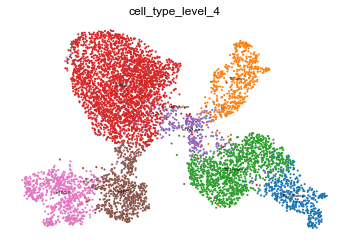

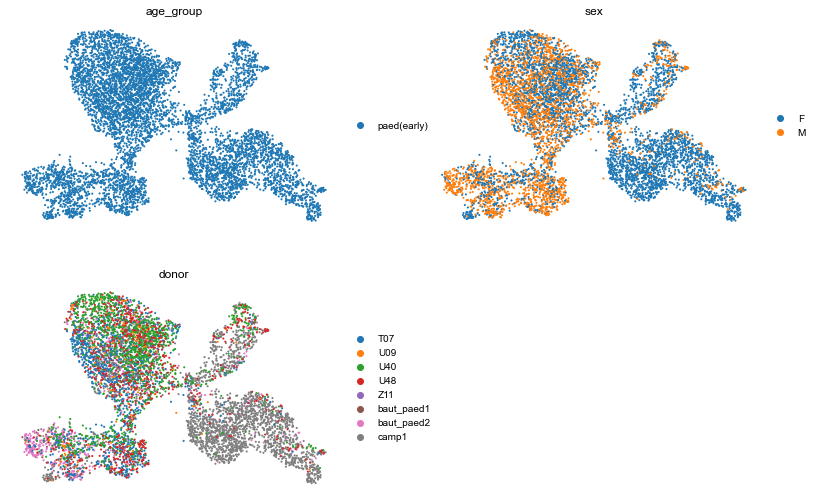

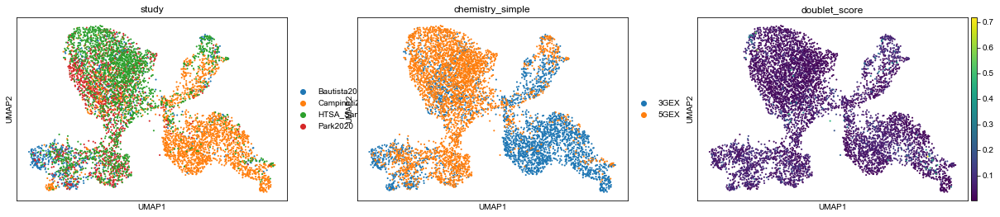

In [19]:
adata_mtec_scvi_run = run_scvi2(adata_mtec,  batch_hv="chemistry_simple", batch_scvi="donor", hvg = 2000,
          cat_cov_scvi=['chemistry_simple','donor', 'sex'], cont_cov_scvi = None, include_genes=[], 
          exclude_cc_genes=True, exclude_vdjgenes=True, exclude_mt_genes = True, 
          n_layers=2, n_latent=30, max_epochs=350, batch_size=2000)

In [23]:
adata_mtec=adata_mtec_scvi_run['data'].copy()

In [30]:
adata_mtec.obs['cell_type_level_4_explore'].cat.reorder_categories(['mTECI',
       'mTECII', 'mTECIII', 'mTECI-trans', 'TEC-neuro', 'TEC-cilliated',
       'TEC-myo', 'TEC-tuft'], inplace = True)

In [37]:
adata_mtec.obs['cell_type_level_4_explore'].cat.categories

Index(['mTECI', 'mTECII', 'mTECIII', 'mTECI-trans', 'TEC-neuro',
       'TEC-cilliated', 'TEC-myo', 'TEC-tuft'],
      dtype='object')

In [46]:
adata_mtec.uns['cell_type_level_4_explore_colors'] = [ '#be023a',
 '#018de8',
 '#a74c56', 
 '#3f065a',
 '#cedc85',
 '#533cad',
 '#597000',
 '#eb71de']

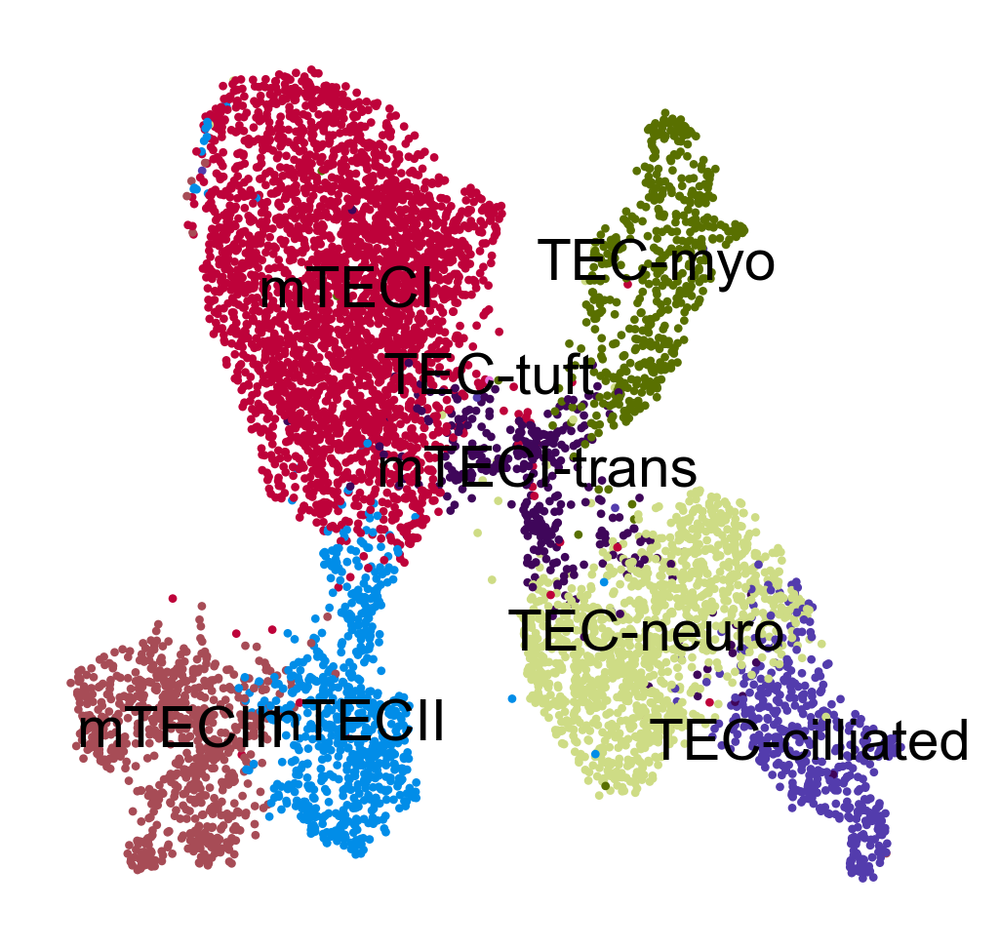

In [47]:
sc.pl.umap(adata_mtec, color = 'cell_type_level_4_explore', title = '', frameon = False, legend_loc = "on data",
          save = "mTEC_UMAP_fig5g.pdf")

In [9]:
adata_tec.obs['cell_type_level_4_upd'].value_counts()

mcTEC            3116
mTECI            2756
cTECIII          2146
cTECI            1983
cTECII           1615
TEC-neuro        1226
mTECIII           746
mTECII            671
TEC-myo           506
TEC-cilliated     478
mTECI-trans       297
mTECI-Prolif      164
mcTEC-Prolif       72
TEC-ionocytes      31
Name: cell_type_level_4_upd, dtype: int64

### Further subset to mTECII and mTECIII

In [13]:
adata_mtec_ss = adata_tec[(adata_tec.obs['cell_type_level_4_upd'].isin(['mTECII', 'mTECIII'])) &
                          (adata_tec.obs['age_group'] != 'fetal'),].copy()

In [14]:
adata_mtec_ss.shape

(1417, 36601)

# batch correct with scvi

Removed excluded genes
Highly variable genes selected in total (1417, 2000)
INFO     Using batches from adata.obs["donor"]                                               
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.X                                                             
INFO     Successfully registered anndata object containing 1417 cells, 2000 vars, 7 batches, 
         1 labels, and 0 proteins. Also registered 3 extra categorical covariates and 0 extra
         continuous covariates.                                                              
INFO     Please do not further modify adata until model is trained.                          


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 400/400: 100%|██████████| 400/400 [00:16<00:00, 23.58it/s, loss=1e+03, v_num=1]   
scvi model trained
DR and clustering performed


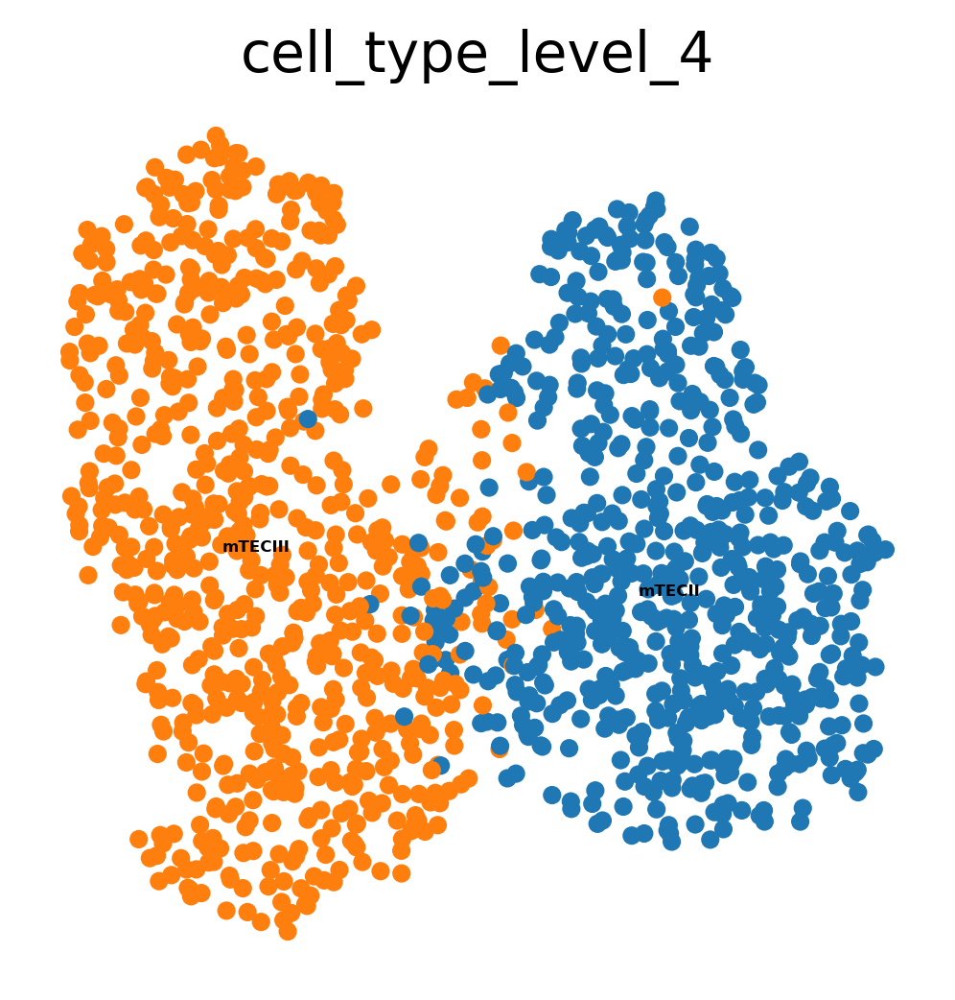

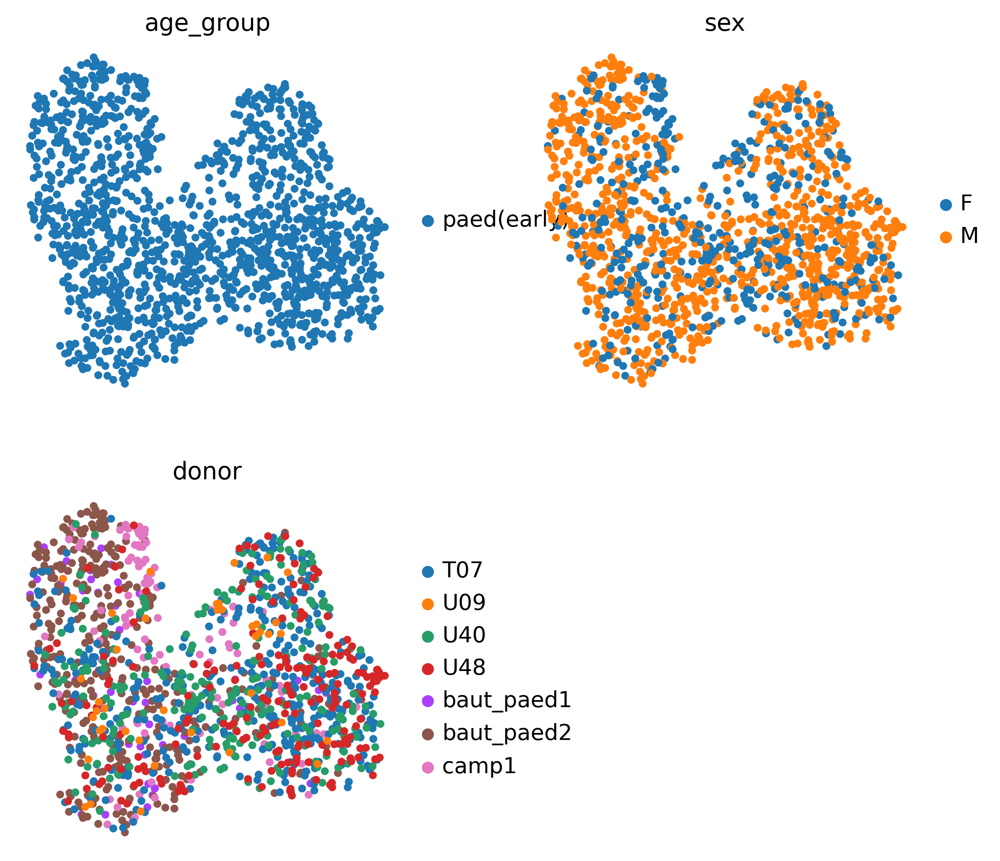

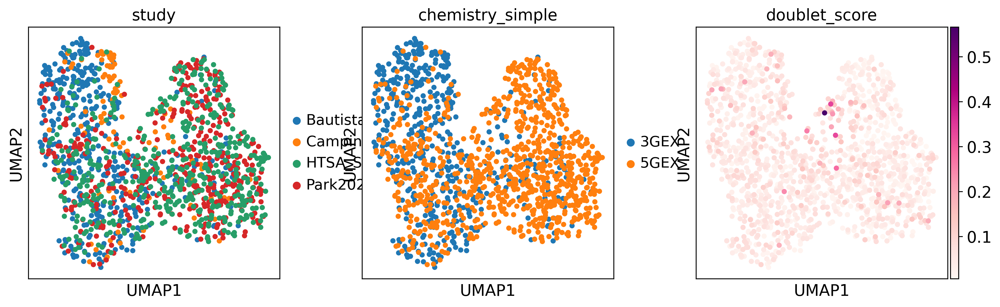

In [15]:
adata_mtec_ss_scvi_run = run_scvi2(adata_mtec_ss,  batch_hv="chemistry_simple", batch_scvi="donor", hvg = 2000,
          cat_cov_scvi=['chemistry_simple','donor', 'sex'], cont_cov_scvi = None, include_genes=[], 
          exclude_cc_genes=True, exclude_vdjgenes=True, exclude_mt_genes = True, 
          n_layers=2, n_latent=30, max_epochs=350, batch_size=2000)

In [20]:
adata_mtec_ss = adata_mtec_ss_scvi_run['data'].copy()

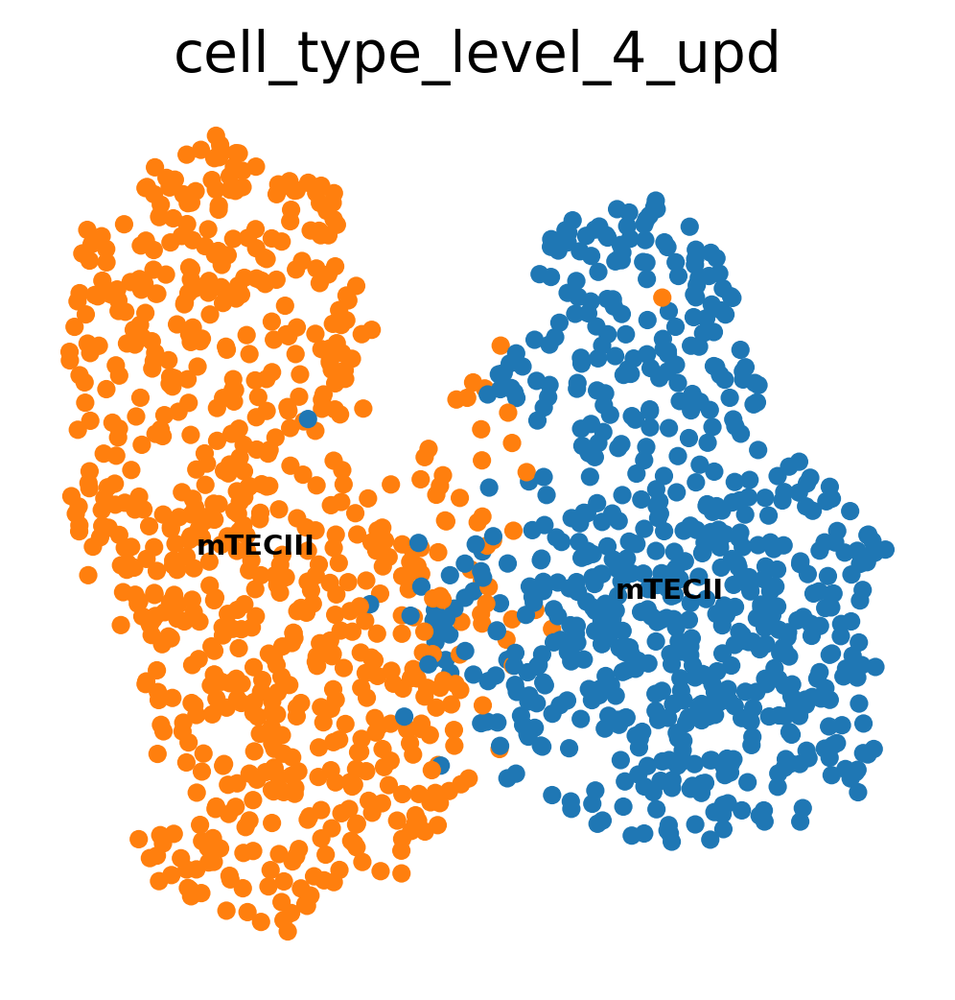

In [22]:
sc.pl.umap(adata_mtec_ss, color = ['cell_type_level_4_upd'], frameon = False, legend_loc = "on data",
          legend_fontsize = 7)

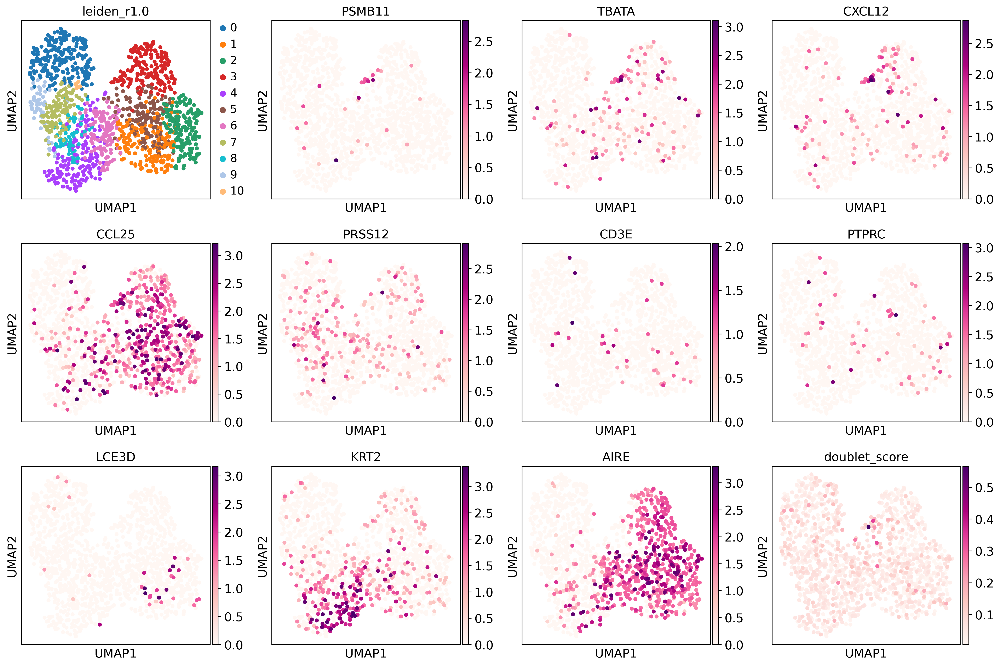

In [24]:
sc.pl.umap(adata_mtec_ss, color = ['leiden_r1.0', 'PSMB11', 'TBATA', 'CXCL12', 'CCL25', 'PRSS12', 'CD3E', 'PTPRC', 'LCE3D', 
                                  'KRT2', 'AIRE', 'doublet_score'])

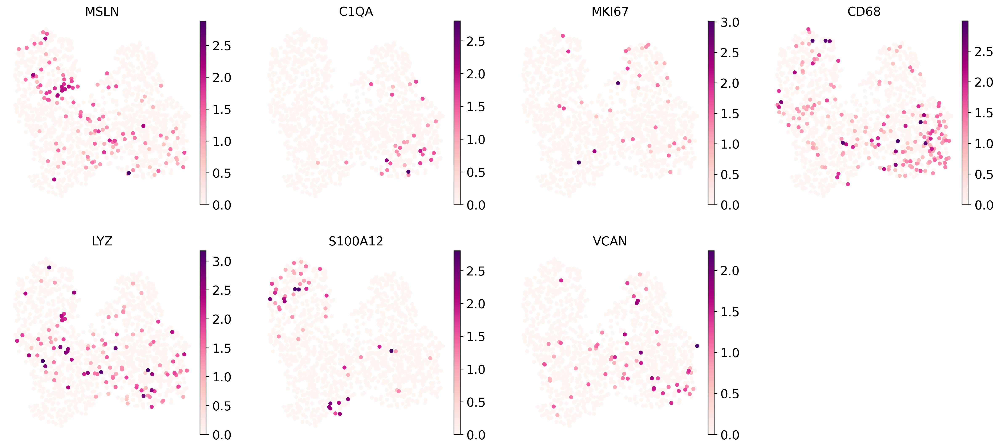

In [26]:
sc.pl.umap(adata_mtec_ss, color = ['MSLN','C1QA','MKI67', 'CD68', 'LYZ', 'S100A12', 'VCAN'], frameon = False, legend_loc = "on data",
          legend_fontsize = 7)

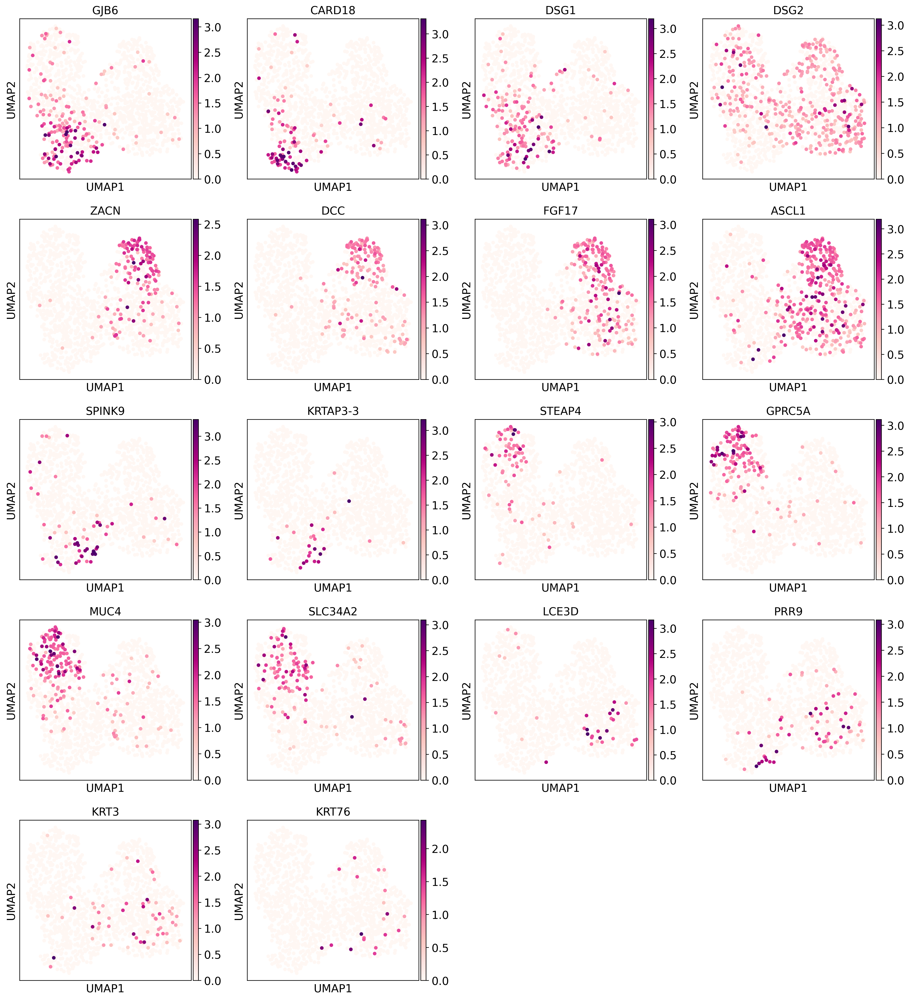

In [27]:
sc.pl.umap(adata_mtec_ss, color = ['GJB6', 'CARD18', 'DSG1', 'DSG2', \
                                       'ZACN', 'DCC', 'FGF17', 'ASCL1',\
                                       'SPINK9', 'KRTAP3-3', 
                                       'STEAP4', 'GPRC5A', 'MUC4', 'SLC34A2',
                                       'LCE3D', 'PRR9', 'KRT3', 'KRT76'])

# save object 

In [29]:
from datetime import date
today = str(date.today())

In [30]:
adata_mtec_ss.write(f'{results}HTSA_mTECII_III_scvi_{today}.h5ad')

# load object 

In [ ]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import warnings 
import scipy.stats
from collections import Counter
import os
import scFates as scf
#import palantir
## fix palantir breaking down some plots
import seaborn
seaborn.reset_orig()
%matplotlib inline
from matplotlib import font_manager 
font_manager.fontManager.addfont("/nfs/team205/ny1/ThymusSpatialAtlas/software/Arial.ttf") 
print(font_manager.findfont("Arial")) 
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.set_figure_params()
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'pdf')

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

from datetime import date
today = str(date.today())

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
#model_folder = '/nfs/team205/ny1/ThymusSpatialAtlas/Figure4/scvi_models/'
figures = '/nfs/team205/ny1/ThymusSpatialAtlas/Figure_5_nat/figures/'
results = '/nfs/team205/ny1/ThymusSpatialAtlas/Figure_5_nat/'

In [ ]:
source_folder = '/nfs/team205/ny1/ThymusSpatialAtlas/SourceData'

In [ ]:
adata = sc.read(f'{results}/HTSA_mTECII_III_scvi_2024-01-22.h5ad')

In [ ]:
adata.X.data
adata.layers['counts'].data

In [ ]:
adata.X = adata.layers['counts'].copy()

/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


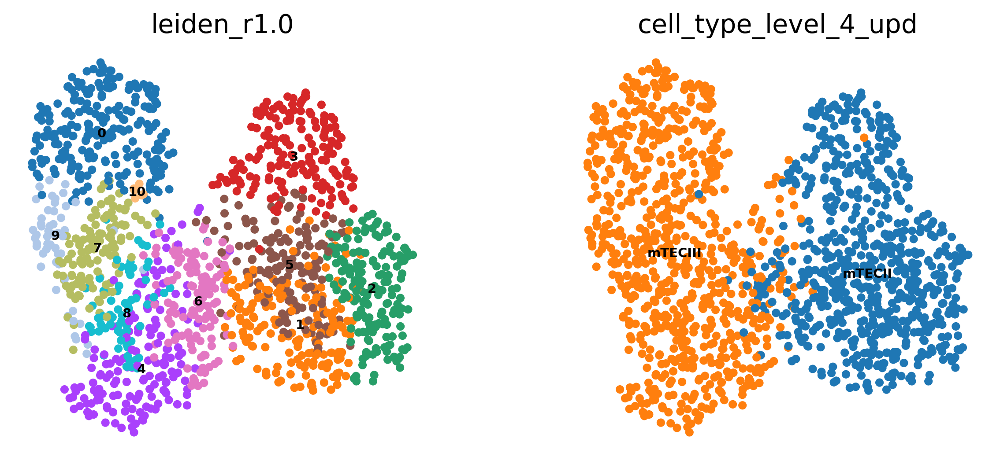

In [10]:
sc.pl.umap(adata, color = ['leiden_r1.0','cell_type_level_4_upd',], frameon = False, legend_loc = "on data",
          legend_fontsize = 7);

In [11]:
sc.pp.normalize_per_cell(adata)
palantir.preprocess.log_transform(adata)

# Run palantir 

In [12]:
scvi_projections = pd.DataFrame(adata.obsm["X_scVI"],index=adata.obs_names)

In [13]:
dm_res = palantir.utils.run_diffusion_maps(scvi_projections, n_components = 30)

Determing nearest neighbor graph...


/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-

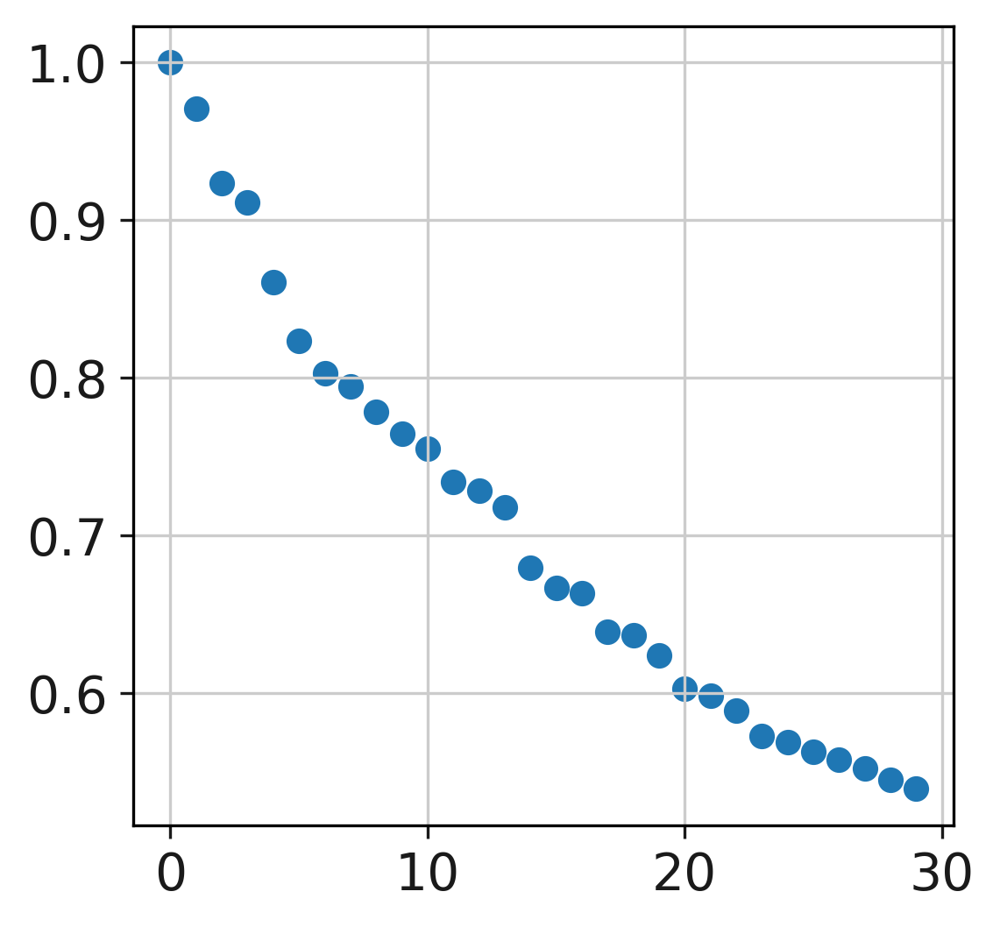

In [16]:
plt.scatter(np.arange(30), dm_res['EigenValues'])

In [17]:
ms_data = palantir.utils.determine_multiscale_space(dm_res,n_eigs=4)

In [18]:
# generate neighbor draph in multiscale diffusion space
adata.obsm["X_palantir"]=ms_data.values
sc.pp.neighbors(adata,n_neighbors=30,use_rep="X_palantir")

In [19]:
# draw ForceAtlas2 embedding using 2 first PCs as initial positions
adata.obsm["X_pca2d"]=adata.obsm["X_scVI"][:,:2]
sc.tl.draw_graph(adata,init_pos='X_scVI')

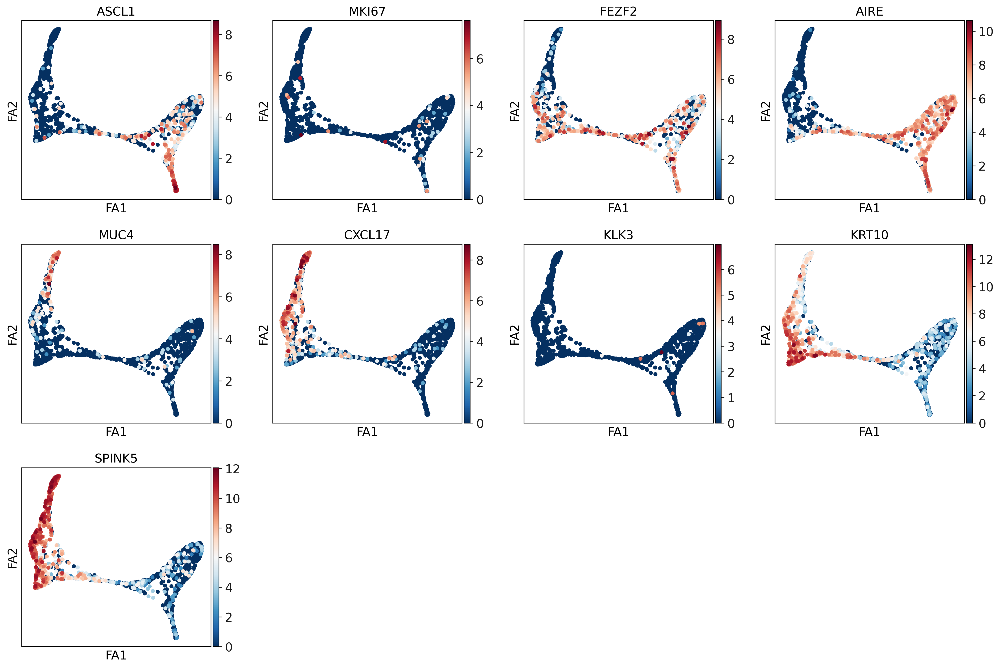

In [25]:
sc.pl.draw_graph(adata,color=["ASCL1","MKI67","FEZF2", "AIRE", "MUC4", "CXCL17", "KLK3", "KRT10", "SPINK5"],color_map="RdBu_r")

/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


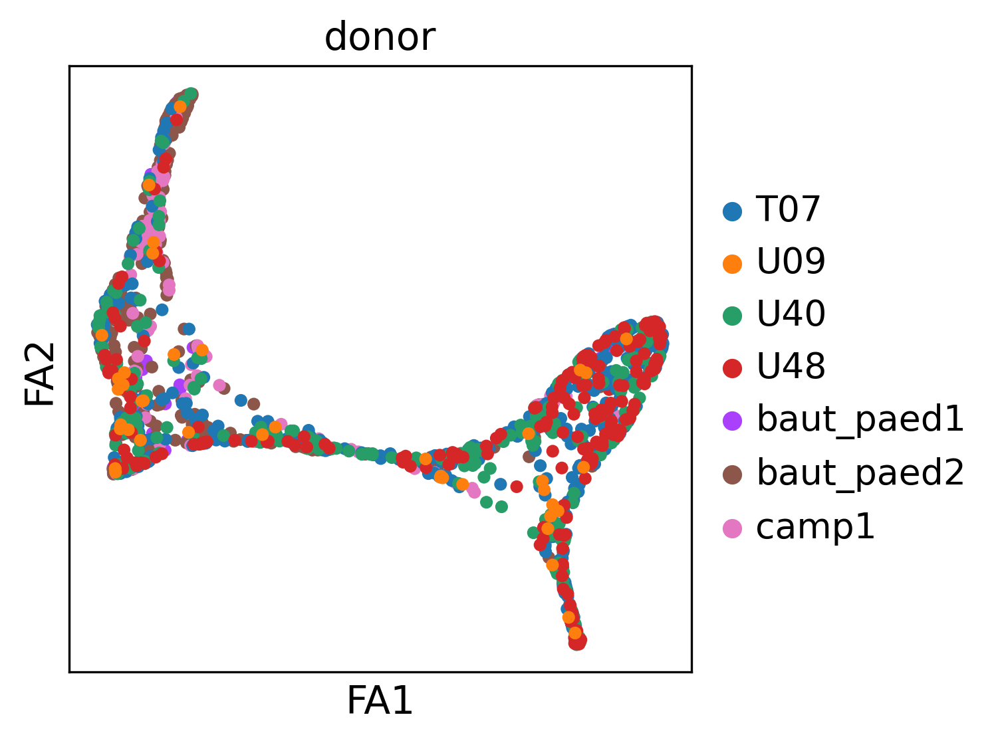

In [21]:
sc.pl.draw_graph(adata,color=["donor"],color_map="RdBu_r")

/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


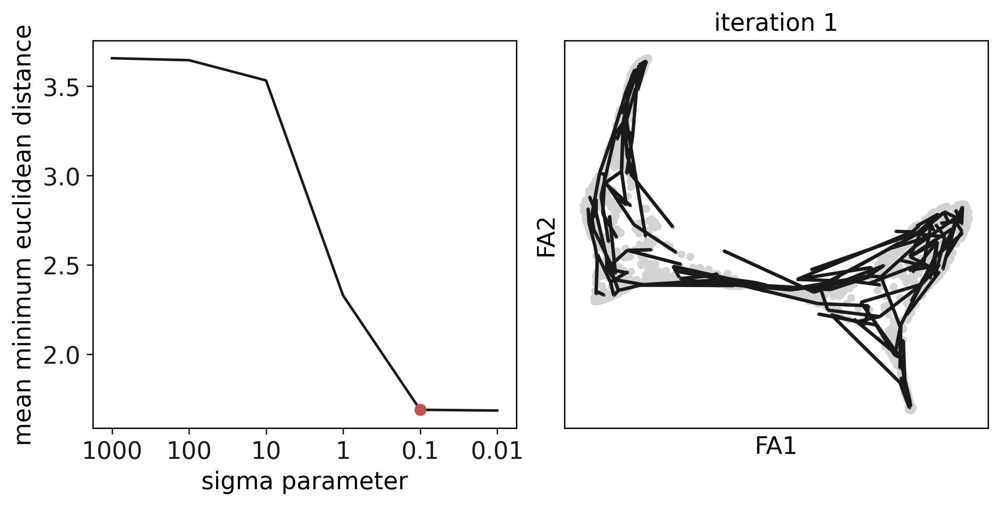

In [22]:
sig=scf.tl.explore_sigma(adata,200,"X_scVI",seed=42,plot=True)

In [23]:
scf.tl.tree(adata,method="ppt",Nodes=200,use_rep="palantir",
            device="cpu",seed=1,ppt_lambda=100,ppt_sigma=sig,ppt_nsteps=200)

inferring a principal tree --> parameters used 
    200 principal points, sigma = 0.1, lambda = 100, metric = euclidean
    fitting:  34%|█████████████████████▋                                         | 69/200 [00:07<00:14,  9.04it/s]
    converged
    finished (0:00:07) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


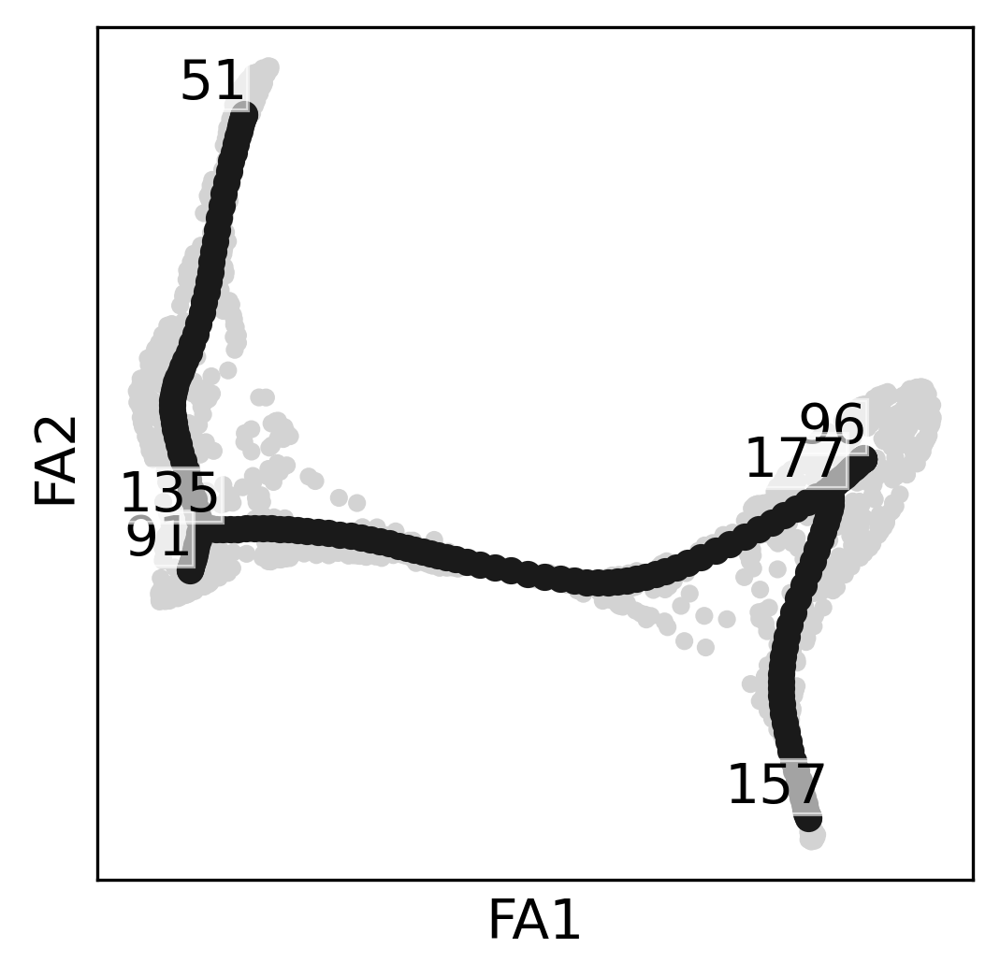

In [24]:
scf.pl.graph(adata)


In [26]:
scf.tl.root(adata,157)

node 157 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.


In [27]:
scf.tl.pseudotime(adata,n_jobs=6,n_map=100,seed=42)

projecting cells onto the principal graph
    mappings: 100%|█████████████████████████████████████████████████████████████| 100/100 [00:51<00:00,  1.94it/s]
    finished (0:00:52) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


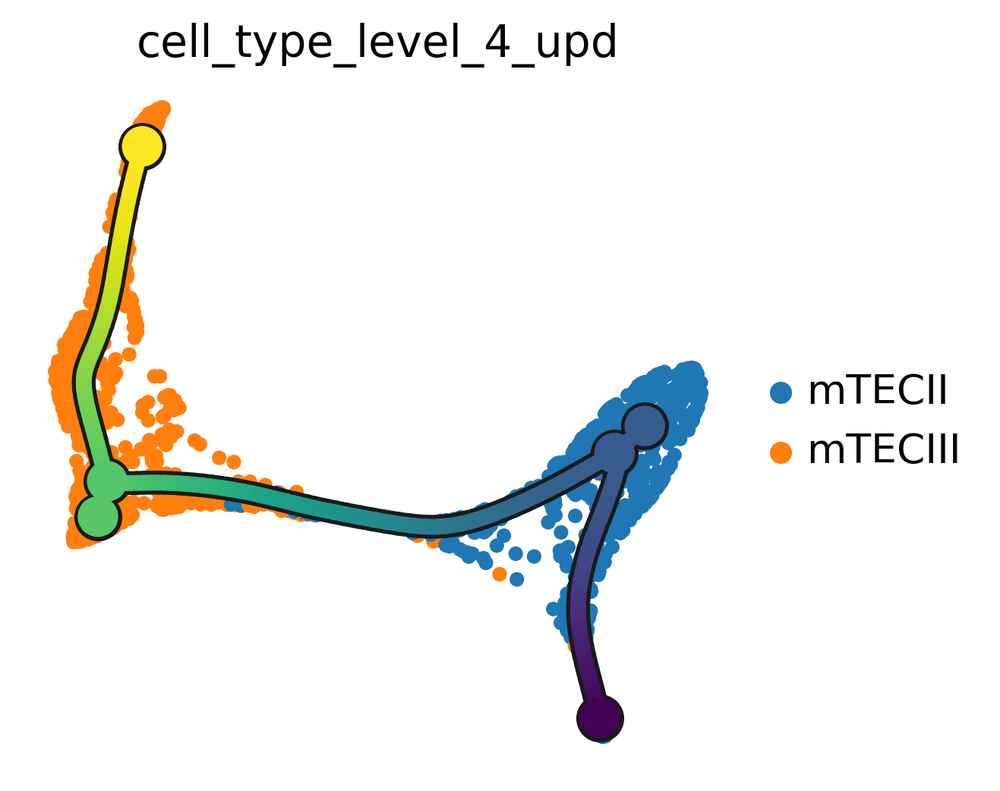

In [28]:
scf.pl.trajectory(adata, color_cells ='cell_type_level_4_upd', frameon = False, save = "mTECII_III_trajectory_tree")

/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


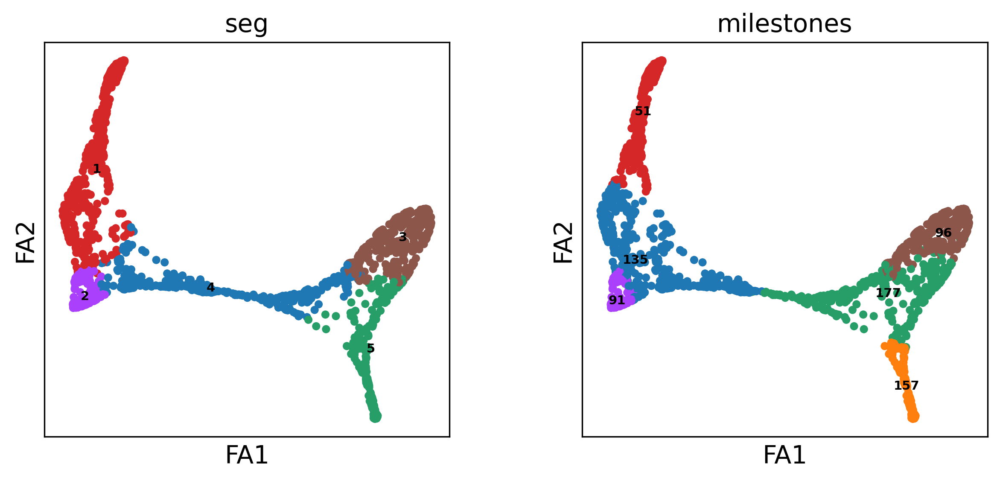

In [29]:
sc.pl.draw_graph(adata,color=["seg","milestones"], color_map="RdBu_r", legend_loc = "on data",
                legend_fontsize = 7)

/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


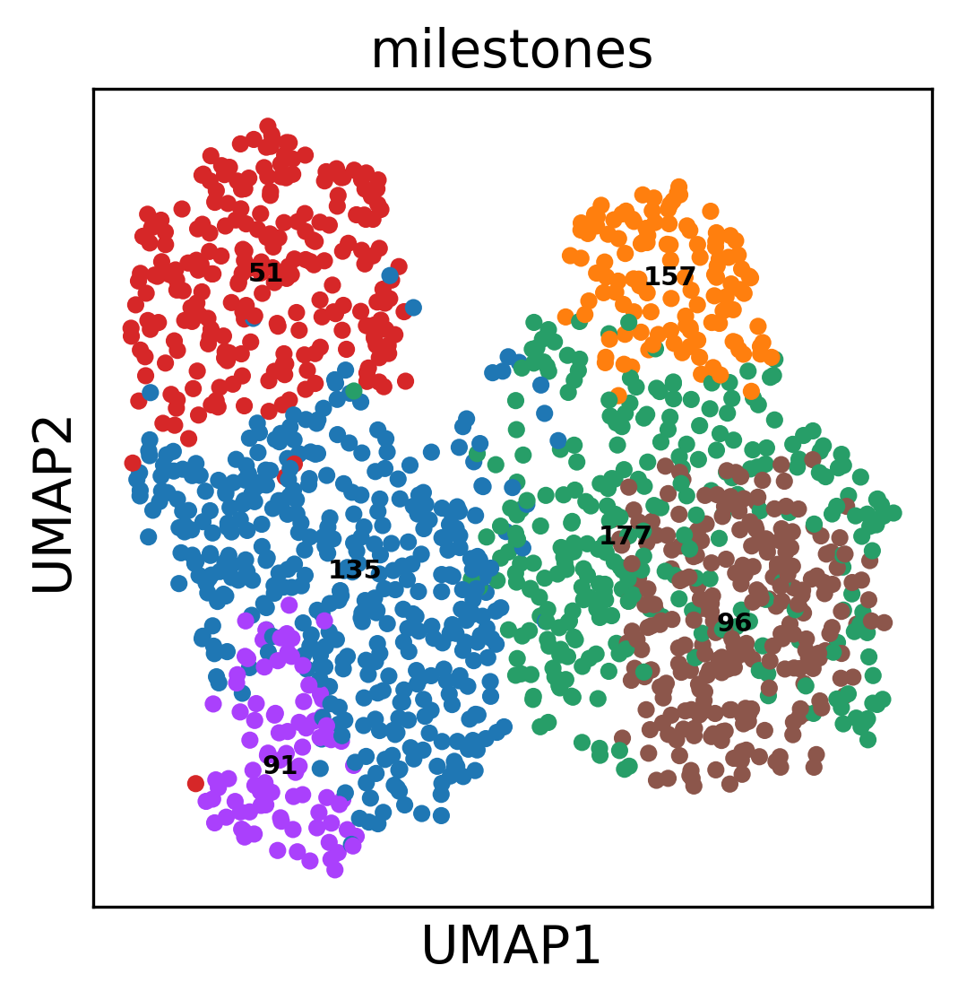

In [30]:
sc.pl.umap(adata, color = 'milestones', color_map="RdBu_r", legend_loc = "on data",
                legend_fontsize = 7)

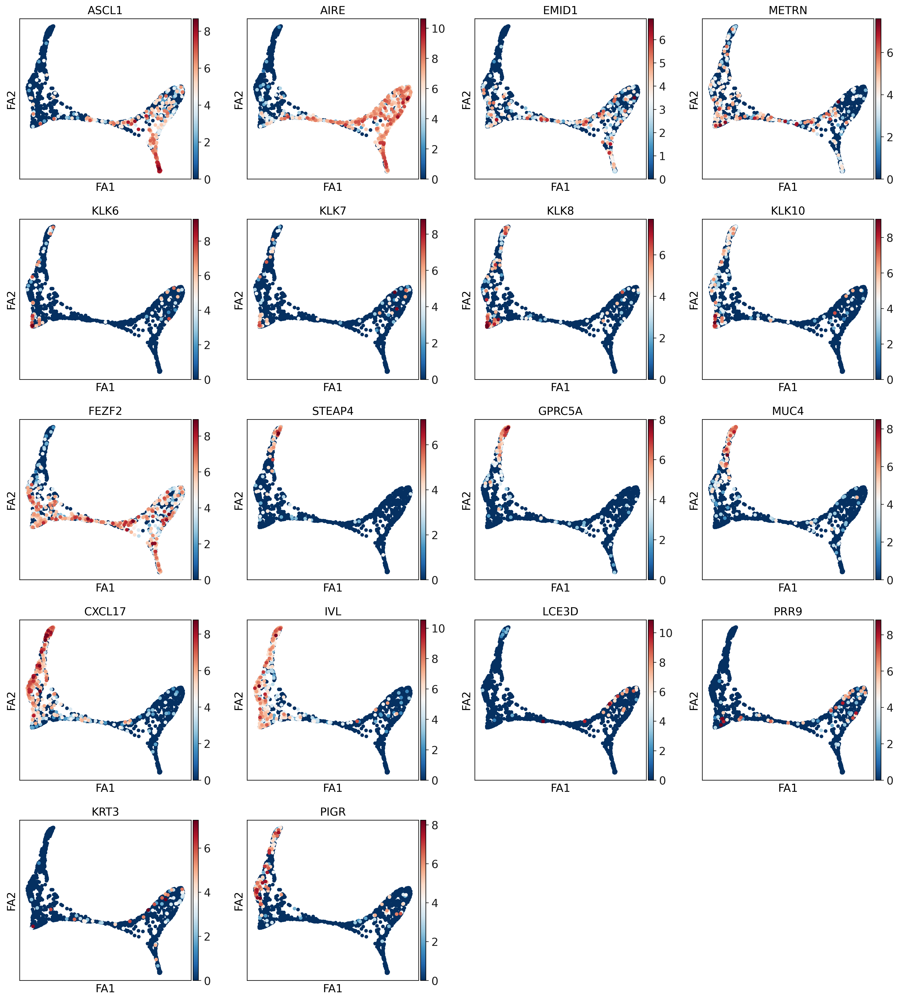

In [31]:
sc.pl.draw_graph(adata,color=['ASCL1', 'AIRE', 'EMID1', 'METRN', 'KLK6', 'KLK7', 'KLK8', 'KLK10',
                              'FEZF2', 'STEAP4', 'GPRC5A', 'MUC4', 'CXCL17', 'IVL',
                             'LCE3D', 'PRR9', 'KRT3', 'PIGR'], color_map="RdBu_r", legend_loc = "on data",
                legend_fontsize = 7)

/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


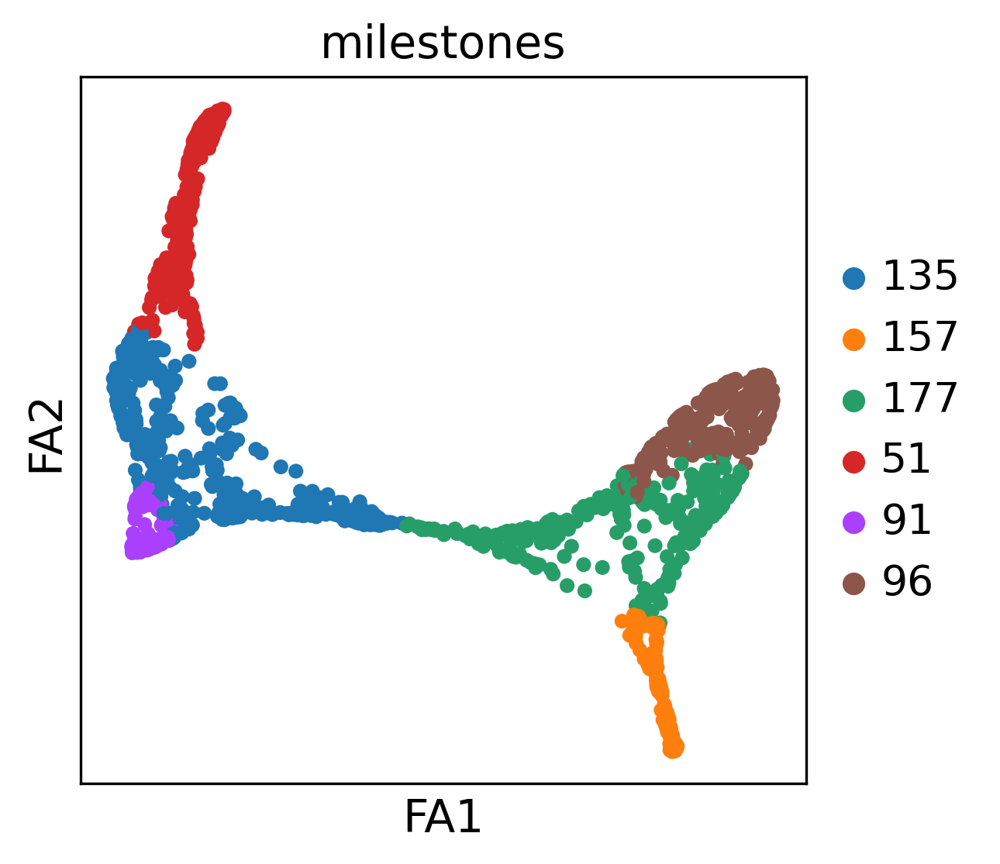

In [32]:
sc.pl.draw_graph(adata,color=["milestones"], color_map="RdBu_r")

In [34]:
adata.obs['milestones'].cat.categories

Index(['135', '157', '177', '51', '91', '96'], dtype='object')

In [35]:
scf.tl.rename_milestones(adata,["mTECIII_trans", "mTECII_early", "mTECII_trans",  "mTECIII_MUC4",
                                "mTECIII_KRT10hi","mTECII"])
# we change the color of the root milestone for better visualisations
adata.uns["milestones_colors"][1]="#17bece"

/nfs/team205/vk8/mambaforge/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


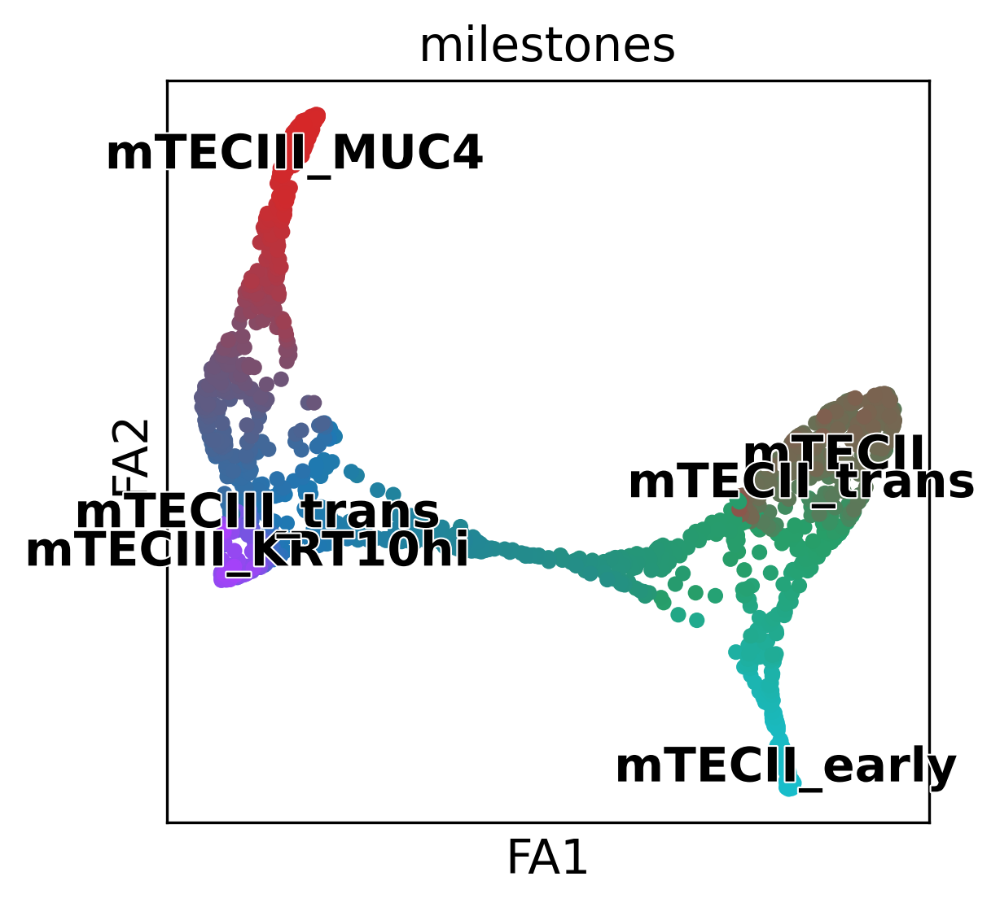

In [39]:
scf.pl.milestones(adata, annotate=True,  save = "mTECII_III_trajectory_annotated")

# generate plots for figure

# load trajectory object 

In [ ]:

sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'pdf')

adata = sc.read('/nfs/team205/ny1/ThymusSpatialAtlas/Figure_5_nat/HTSA_mTECII_III_annot_traj_fit_2024-01-22.h5ad')
adata

In [4]:
adata.uns['cell_type_level_4_upd_colors'] = [ '#018de8','#a74c56']

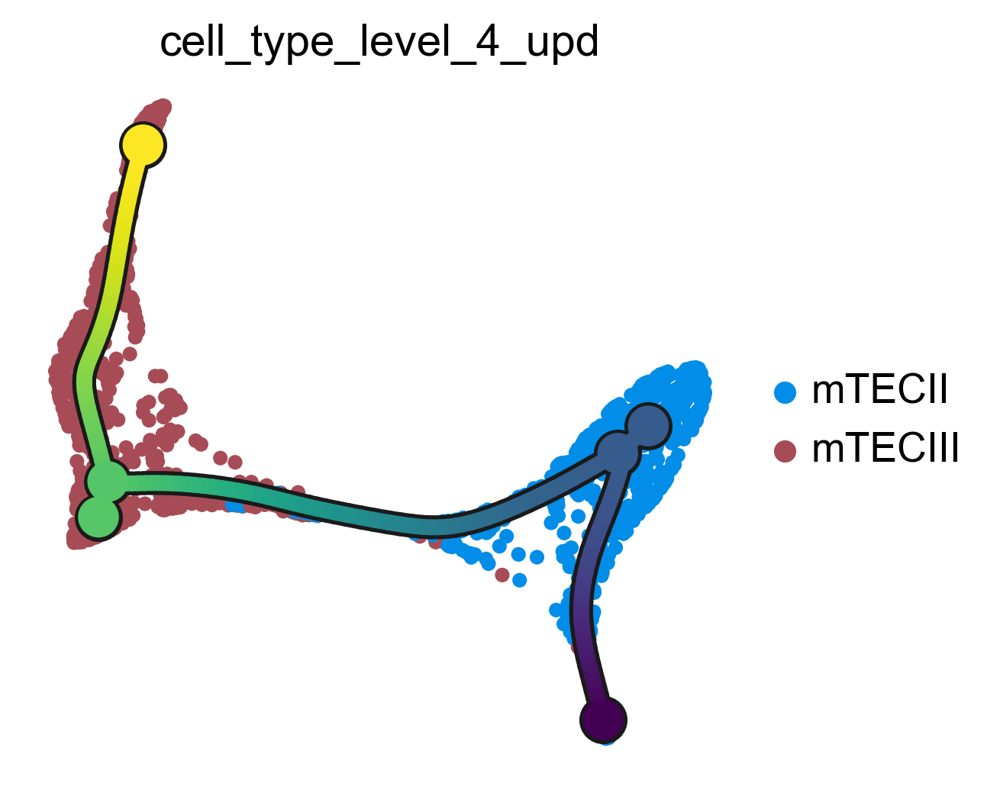

In [12]:
scf.pl.trajectory(adata, color_cells ='cell_type_level_4_upd', frameon = False, save = "mTECII_mTECIII_trajectory.pdf")

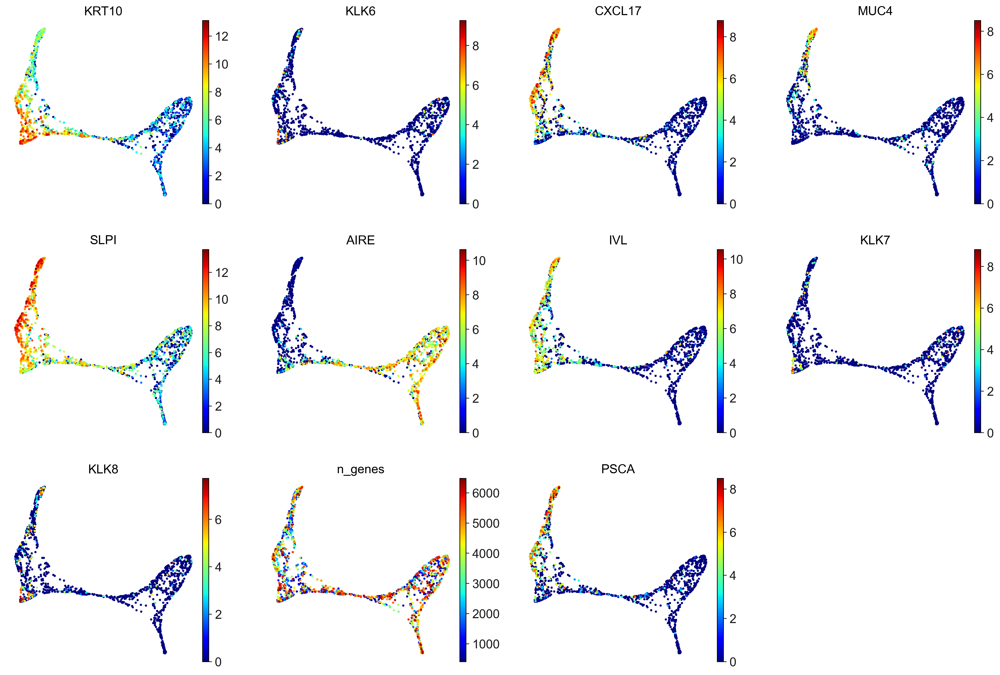

In [16]:
sc.pl.draw_graph(adata,color=['KRT10',"KLK6",'CXCL17',"MUC4",'SLPI','AIRE','IVL','KLK7','KLK8','n_genes','PSCA'],color_map="jet",save='KLK_MUC_time_v2.pdf',frameon=False,s=25)

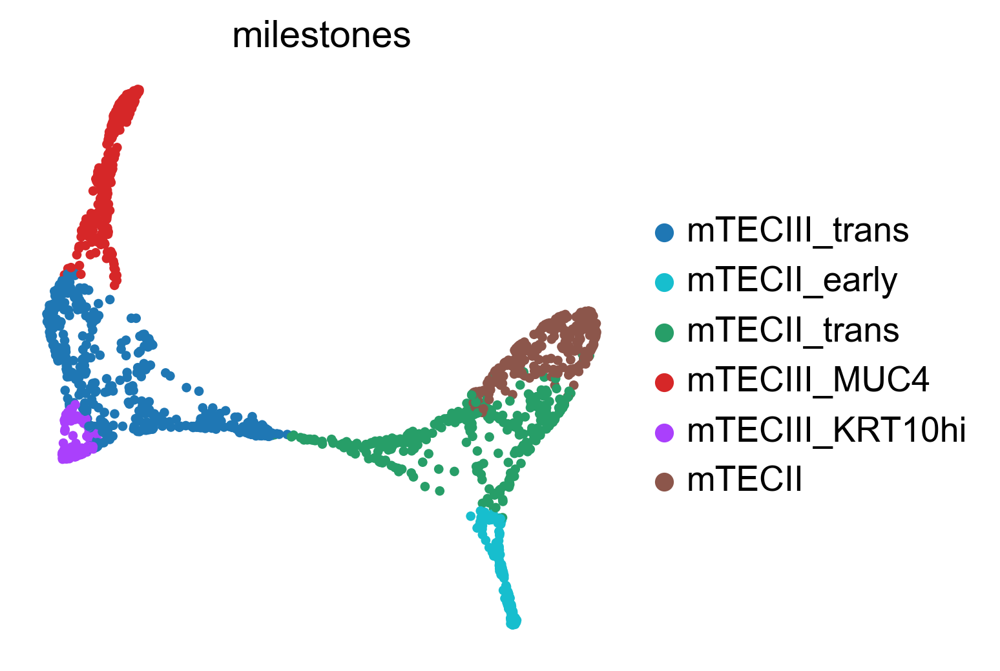

In [17]:
sc.pl.draw_graph(adata,color=['milestones'],color_map="jet",save='mTECII_III_trajectory_annotated_milestones.pdf',s=50,frameon=False)

In [43]:
scf.tl.test_association(adata,n_jobs=6)
scf.tl.fit(adata,n_jobs=6)

test features for association with the trajectory
    single mapping : 100%|██████████████████████████████████████████████████| 36601/36601 [14:12<00:00, 42.92it/s]
    found 2907 significant features (0:14:12) --> added
    .var['p_val'] values from statistical test.
    .var['fdr'] corrected values from multiple testing.
    .var['st'] proportion of mapping in which feature is significant.
    .var['A'] amplitue of change of tested feature.
    .var['signi'] feature is significantly changing along pseudotime.
    .uns['stat_assoc_list'] list of fitted features on the graph for all mappings.
fit features associated with the trajectory
    single mapping : 100%|████████████████████████████████████████████████████| 2907/2907 [01:59<00:00, 24.40it/s]
    finished (adata subsetted to keep only fitted features!) (0:02:01) --> added
    .layers['fitted'], fitted features on the trajectory for all mappings.
    .raw, unfiltered data.


In [44]:
adata.write(f'{results}/HTSA_mTECII_III_annot_traj_fit_{today}.h5ad')

In [5]:
scf.tl.test_fork(adata,root_milestone="mTECII_early",
                 milestones=["mTECIII_KRT10hi", "mTECIII_MUC4", "mTECII"],n_jobs=5,rescale=True)

testing fork
    single mapping
    Differential expression: 100%|█| 2907/2907 [
    test for upregulation for each leave vs root
    upreg mTECIII_KRT10hi: 100%|█| 573/573 [00:0
    upreg mTECIII_MUC4: 100%|█| 766/766 [00:01<0
    upreg mTECII: 100%|█| 1568/1568 [00:02<00:00
    finished (0:02:08) --> added 
    .uns['mTECII_early->mTECIII_KRT10hi<>mTECIII_MUC4<>mTECII']['fork'], DataFrame with fork test results.


In [6]:
scf.tl.branch_specific(adata,root_milestone="mTECII_early",
                 milestones=["mTECIII_KRT10hi", "mTECIII_MUC4", "mTECII"], effect=1.3)

    branch specific features: mTECIII_KRT10hi: 56, mTECIII_MUC4: 49, mTECII: 6
    finished --> updated 
    .uns['mTECII_early->mTECIII_KRT10hi<>mTECIII_MUC4<>mTECII']['fork'], DataFrame updated with additionnal 'branch' column.


In [7]:
res = adata.uns['mTECII_early->mTECIII_KRT10hi<>mTECIII_MUC4<>mTECII']['fork'].copy()

In [9]:
marker_dict_1 = np.load('/nfs/team205/ny1/ThymusSpatialAtlas/Figure_5_nat/marker_genes_max_1_v5.npy',allow_pickle=True).item()

In [10]:
count = 0
for key in marker_dict_1.keys():
    print(f'{key}:{str(len(marker_dict_1[key]))}')
    count = count + len(marker_dict_1[key])
print (count)

B-memory:3
DC1:3
Macrophage-APOC2:1
TEC-cilliated:1
TEC-myo:18
TEC-neuro:1
T_CD8αα(II):1
T_NK:2
T_Treg_recirc:3
aDC1:1
aDC3:1
mTECII:53
mTECIII:93
pDC:3
184


In [16]:
sge = marker_dict_1['mTECII']+marker_dict_1['mTECIII']

In [17]:
len(sge)

146

In [18]:
sge_de_branch = [i for i in sge if i in adata.uns['mTECII_early->mTECIII_KRT10hi<>mTECIII_MUC4<>mTECII']['fork'].index.tolist()]

In [20]:
len(sge_de_branch)

32

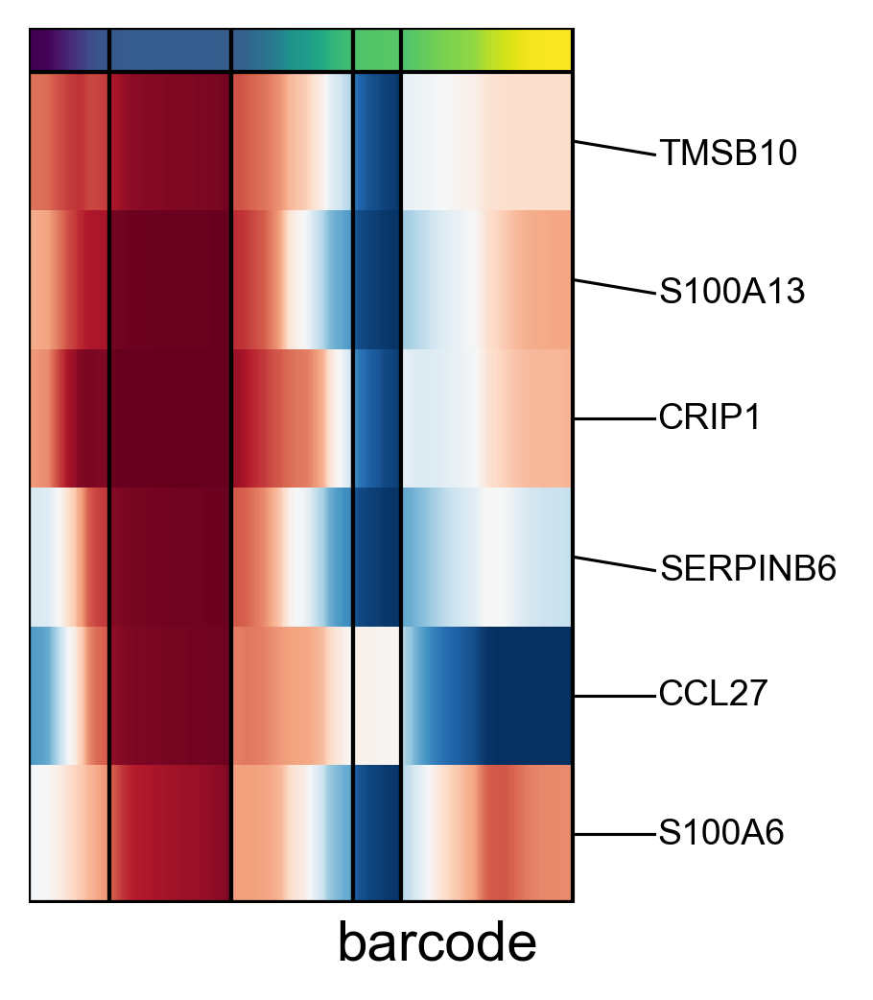

In [21]:
g1=scf.pl.trends(adata,
                 root_milestone="mTECII_early",
                 milestones=["mTECIII_KRT10hi", "mTECIII_MUC4", "mTECII"],
                 branch="mTECII",
                 plot_emb=False,ordering="max",return_genes=True)

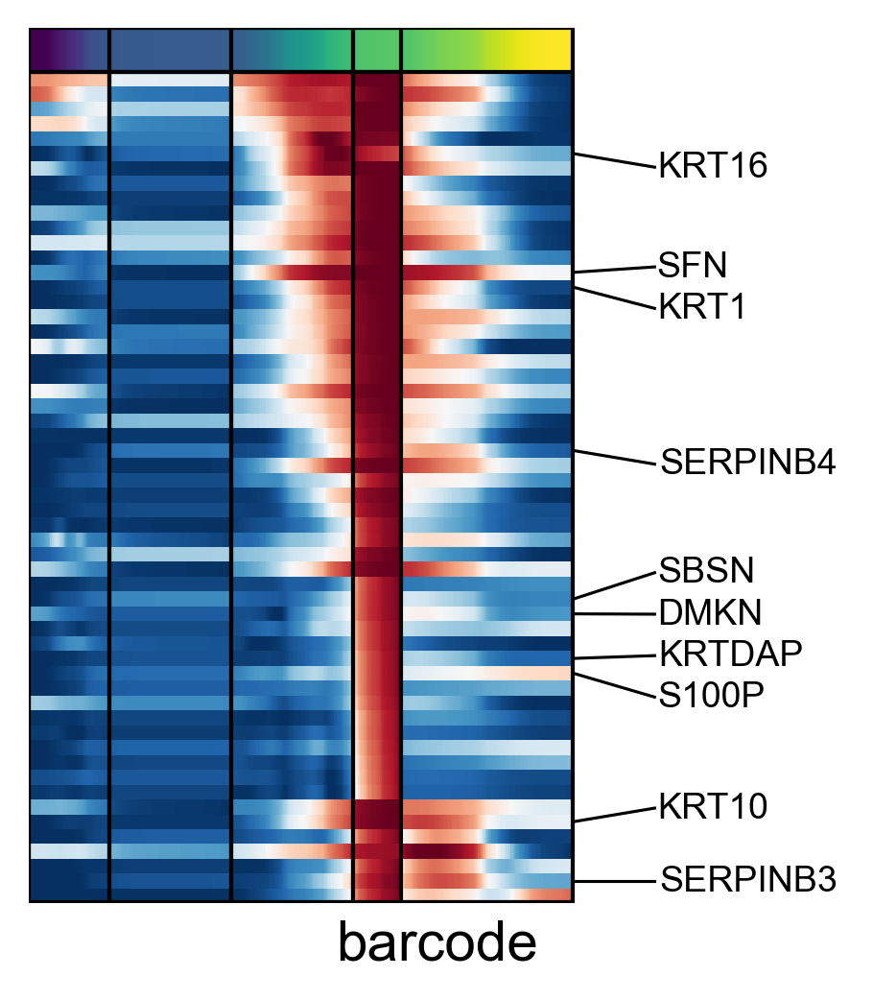

In [22]:
g2=scf.pl.trends(adata,
                 root_milestone="mTECII_early",
                 milestones=["mTECIII_KRT10hi", "mTECIII_MUC4", "mTECII"],
                 branch="mTECIII_KRT10hi",
                 plot_emb=False,ordering="max",return_genes=True)

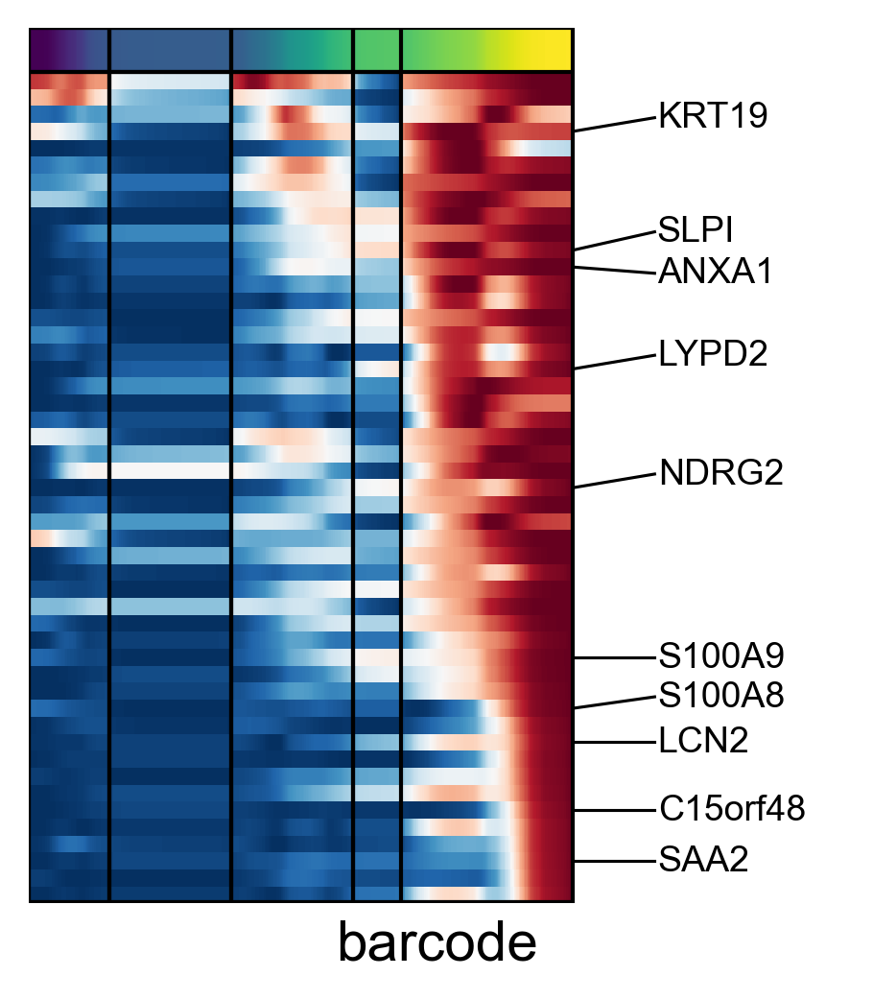

In [23]:
g3=scf.pl.trends(adata,
                 root_milestone="mTECII_early",
                 milestones=["mTECIII_KRT10hi", "mTECIII_MUC4", "mTECII"],
                 branch="mTECIII_MUC4",
                 plot_emb=False,ordering="max",return_genes=True)

In [24]:
gg=g1.tolist()+g2.tolist()+g3.tolist()

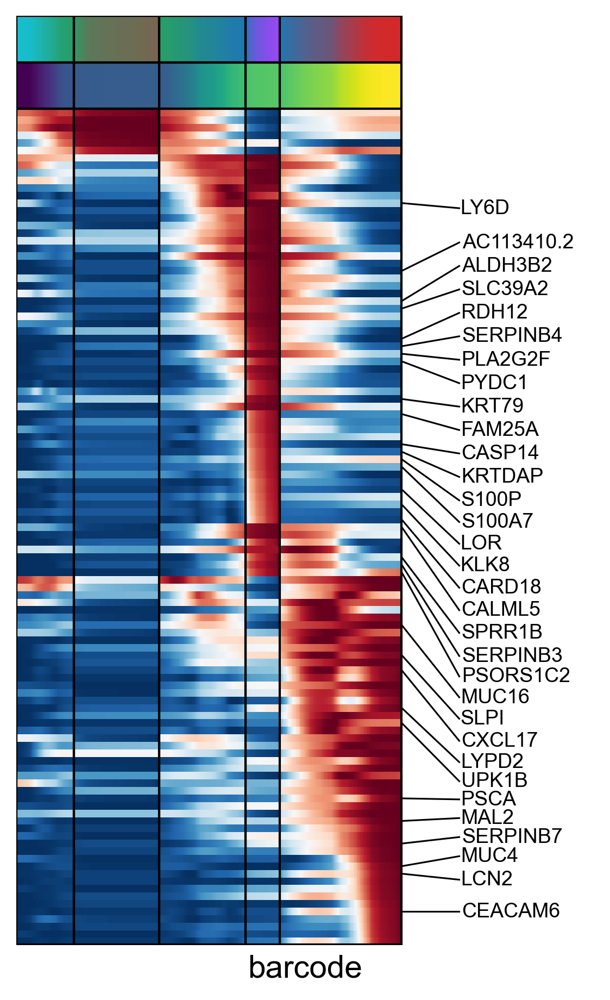

In [28]:
import matplotlib.pyplot as plt
g=scf.pl.trends(adata,gg,figsize=(5,7.5),annot="milestones",highlight_features  = sge_de_branch, 
        plot_emb=False,ordering=None,return_genes=True)
plt.savefig("figures/mTECII_III_traj_genes_3branch_revision_v1.pdf",dpi=300)

In [30]:
adata.write(f'{results}/HTSA_mTECII_III_annot_traj_DE_calc_{today}.h5ad')

In [17]:
adata.uns['mTECII_early->mTECIII_KRT10hi<>mTECIII_MUC4<>mTECII']['fork'].to_csv(f'{source_folder}/mTECII-mTECIII_traj_analysis_DEgenes.csv')